# 0.0. Imports

In [1]:
import pickle
import pandas as pd
import numpy as np
import seaborn as sns
import scikitplot as skplt

from matplotlib import pyplot as plt
from sklearn import preprocessing as pp
from sklearn import model_selection as ms
from sklearn import ensemble as en
from sklearn import neighbors as nh
from sklearn import linear_model as lm

## 0.1. Loading Dataset

In [2]:
df_raw = pd.read_csv('../data/raw/train.csv')

# 1.0. Data Description

In [3]:
df1 = df_raw.copy()

In [4]:
cols_new = ['id', 'gender', 'age', 'driving_license', 'region_code',
       'previously_insured', 'vehicle_age', 'vehicle_damage', 'annual_premium',
       'policy_sales_channel', 'vintage', 'response']

df1.columns = cols_new

In [5]:
df1.columns

Index(['id', 'gender', 'age', 'driving_license', 'region_code',
       'previously_insured', 'vehicle_age', 'vehicle_damage', 'annual_premium',
       'policy_sales_channel', 'vintage', 'response'],
      dtype='object')

## 1.1. Data Dimension

In [6]:
print( 'Number of Rows: {}'.format(df1.shape[0]))
print( 'Number of Columns {}'.format(df1.shape[1]))

Number of Rows: 381109
Number of Columns 12


## 1.2. Data Types

In [7]:
df1.dtypes

id                        int64
gender                   object
age                       int64
driving_license           int64
region_code             float64
previously_insured        int64
vehicle_age              object
vehicle_damage           object
annual_premium          float64
policy_sales_channel    float64
vintage                   int64
response                  int64
dtype: object

## 1.3. Check NA

In [8]:
df1.isna().sum()

id                      0
gender                  0
age                     0
driving_license         0
region_code             0
previously_insured      0
vehicle_age             0
vehicle_damage          0
annual_premium          0
policy_sales_channel    0
vintage                 0
response                0
dtype: int64

## 1.4. Dada Descriptive

In [9]:
num_attributes = df1.select_dtypes( include=['int64', 'float64'])
cat_attributes = df1.select_dtypes( exclude=['int64', 'float64', 'datetime64[ns]'])

In [10]:
# Central Tendency - Mean, Median
ct1 = pd.DataFrame( num_attributes.apply( np.mean )).T
ct2 = pd.DataFrame( num_attributes.apply( np.median)).T

# dispersion - std, min, max, range, skew, kurtosis
d1 = pd.DataFrame( num_attributes.apply(np.std)).T
d2 = pd.DataFrame( num_attributes.apply(min)).T
d3 = pd.DataFrame( num_attributes.apply(max)).T
d4 = pd.DataFrame( num_attributes.apply(lambda x: x.max() - x.min())).T
d5 = pd.DataFrame( num_attributes.apply(lambda x: x.skew())).T
d6 = pd.DataFrame( num_attributes.apply(lambda x: x.kurtosis())).T

# concatenar
m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6]).T.reset_index()
m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,id,1.0,381109.0,381108.0,190555.000000,190555.0,110016.691870,9.443274e-16,-1.200000
1,age,20.0,85.0,65.0,38.822584,36.0,15.511591,6.725390e-01,-0.565655
2,driving_license,0.0,1.0,1.0,0.997869,1.0,0.046109,-2.159518e+01,464.354302
3,region_code,0.0,52.0,52.0,26.388807,28.0,13.229871,-1.152664e-01,-0.867857
4,previously_insured,0.0,1.0,1.0,0.458210,0.0,0.498251,1.677471e-01,-1.971871
5,annual_premium,2630.0,540165.0,537535.0,30564.389581,31669.0,17213.132474,1.766087e+00,34.004569
6,policy_sales_channel,1.0,163.0,162.0,112.034295,133.0,54.203924,-9.000081e-01,-0.970810
7,vintage,10.0,299.0,289.0,154.347397,154.0,83.671194,3.029517e-03,-1.200688
8,response,0.0,1.0,1.0,0.122563,0.0,0.327935,2.301906e+00,3.298788


# 2.0. Feature Engineering

In [11]:
df2 = df1.copy()

In [12]:
# vehicle age
df2['vehicle_age'] = df2['vehicle_age'].apply( lambda x: 'over_2_years' if x == '> 2 Years' else 'between_1_2_year' if x == '1-2 Year' else 'below_1_year' )

# vehicle damage
df2['vehicle_damage'] = df2['vehicle_damage'].apply( lambda x: 1 if x == 'Yes' else 0)

# 3.0. Data Filtering

In [13]:
df3 = df2.copy()

# 4.0. EDA

In [14]:
df4 = df3.copy()

## 4.1. Univariate Analysis

### 4.1.1. Age

<AxesSubplot:xlabel='response', ylabel='age'>

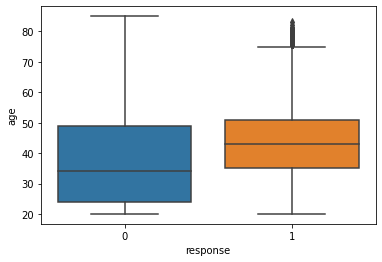

In [15]:
sns.boxplot( x='response', y='age', data=df4)

<AxesSubplot:xlabel='age', ylabel='Count'>

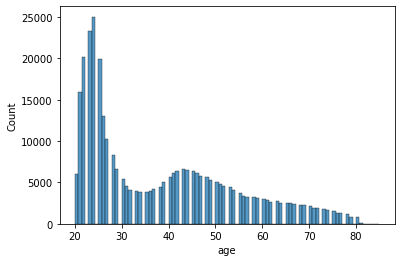

In [16]:
aux00 = df4.loc[df4['response'] == 0, 'age']
sns.histplot(aux00)

<AxesSubplot:xlabel='age', ylabel='Count'>

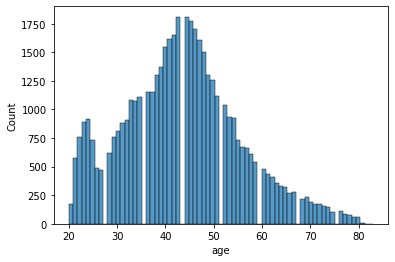

In [17]:
aux00 = df4.loc[df4['response'] == 1, 'age']
sns.histplot(aux00)

### 4.1.2. Annual Premium

<AxesSubplot:xlabel='response', ylabel='annual_premium'>

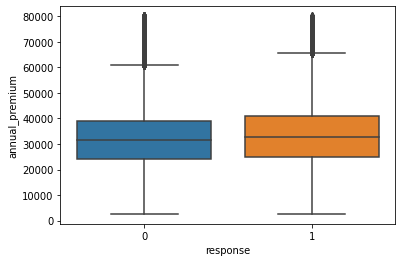

In [18]:
aux = df4[df4['annual_premium'] < 80000]
sns.boxplot( x='response', y='annual_premium', data=aux)

<AxesSubplot:xlabel='annual_premium', ylabel='Count'>

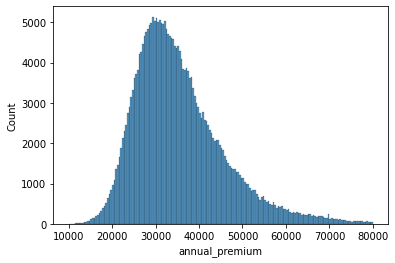

In [19]:
aux = df4[(df4['annual_premium'] > 10000) & (df4['annual_premium'] < 80000)]
aux00 = aux.loc[df4['response'] == 0, 'annual_premium']
sns.histplot(aux00)

<AxesSubplot:xlabel='annual_premium', ylabel='Count'>

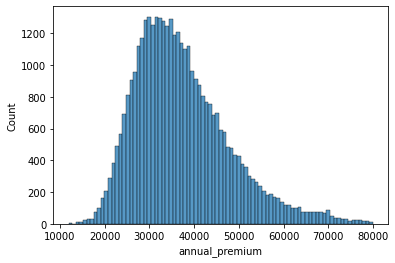

In [20]:
aux00 = aux.loc[df4['response'] == 1, 'annual_premium']
sns.histplot(aux00)

### 4.1.3. Driving License

In [21]:
aux =df4[['driving_license', 'response']].groupby('response').sum().reset_index()
aux.head()
aux['driving_license_perc'] = aux['driving_license'] / aux['driving_license'].sum()
#sns.barplot(x='response', y='driving_license', data=aux)

In [22]:
aux

,response,driving_license,driving_license_perc
0,0,333628,0.877283
1,1,46669,0.122717


### 4.1.4. Region Code

<AxesSubplot:xlabel='region_code', ylabel='id'>

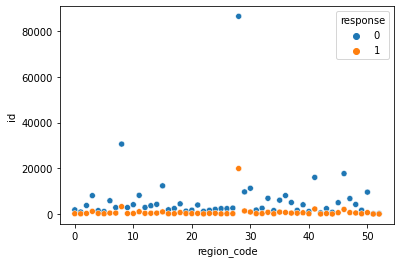

In [23]:
aux0 = df4[['id', 'region_code', 'response']].groupby(['region_code', 'response']).count().reset_index()
sns.scatterplot(x='region_code', y='id', hue='response', data=aux0)

### 4.1.5. Previously Insured

In [24]:
pd.crosstab( df4['previously_insured'], df4['response']).apply( lambda x: x / x.sum(), axis=1)

response,0,1
previously_insured,,
0,0.774546,0.225454
1,0.999095,0.000905


### 4.1.6. Verhcle Age

In [25]:
df4[['vehicle_age', 'response']].value_counts(normalize=True).reset_index()

,vehicle_age,response,0
0,between_1_2_year,0,0.434285
1,below_1_year,0,0.413488
2,between_1_2_year,1,0.091328
3,over_2_years,0,0.029663
4,below_1_year,1,0.018897
5,over_2_years,1,0.012338


### 4.1.7. Policy Sales Cannel

<AxesSubplot:xlabel='response', ylabel='policy_sales_channel'>

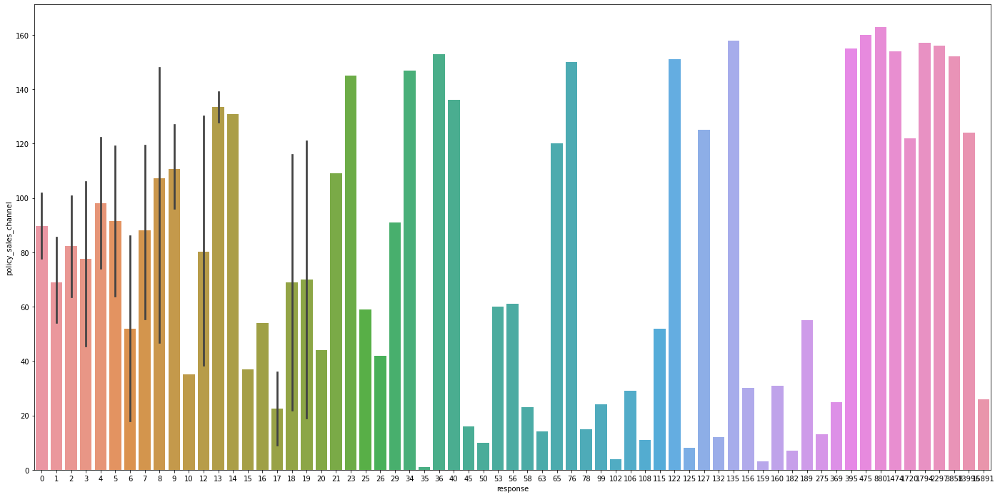

In [26]:
plt.figure( figsize=(24, 12))
aux = df4[['policy_sales_channel','response']].groupby('policy_sales_channel').sum().reset_index()
sns.barplot( x='response', y='policy_sales_channel', data=aux)

### 4.1.8. Vintage

<AxesSubplot:xlabel='response', ylabel='vintage'>

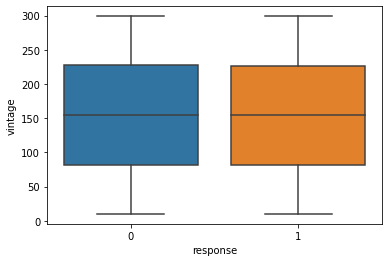

In [27]:
sns.boxplot( x='response', y='vintage', data=df4)

<AxesSubplot:xlabel='vintage', ylabel='Count'>

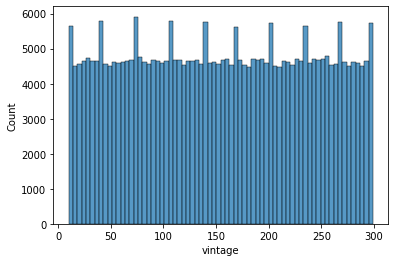

In [28]:
aux00 = df4.loc[df4['response'] == 0, 'vintage']
sns.histplot(aux00)

<AxesSubplot:xlabel='vintage', ylabel='Count'>

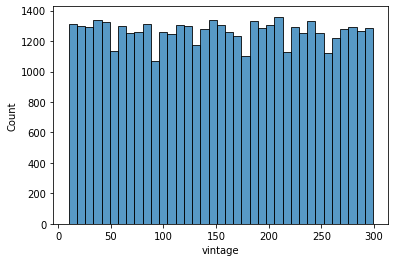

In [29]:
aux00 = df4.loc[df4['response'] == 1, 'vintage']
sns.histplot(aux00)

# 5.0. Data Preparation

In [15]:
df5 = df4.copy()

In [16]:
X = df4.drop( 'response', axis=1)
y = df4['response'].copy()

x_train, x_validation, y_train, y_validation = ms.train_test_split( X, y, test_size=0.20)

df5 = pd.concat( [x_train, y_train], axis=1)

x_validation.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage
10568,10569,Male,49,1,29.0,1,between_1_2_year,0,31191.0,26.0,254
375680,375681,Female,24,1,17.0,0,below_1_year,0,38552.0,152.0,74
80311,80312,Male,50,1,28.0,0,between_1_2_year,0,22031.0,26.0,106
263509,263510,Male,40,1,36.0,0,between_1_2_year,1,50403.0,26.0,145
149612,149613,Female,25,1,27.0,1,below_1_year,0,30180.0,152.0,52


## 5.1. Standardization

In [76]:
ss = pp.StandardScaler()

# annual_premium
df5['annual_premium'] = ss.fit_transform(df5[['annual_premium']].values)
pickle.dump( ss, open('../src/features/annual_premium_scaler.pkl', 'wb'))

## 5.2. Rescaling

In [77]:
mms_age = pp.MinMaxScaler()
mms_vintage = pp.MinMaxScaler()

# Age
df5['age'] = mms_age.fit_transform( df5[['age']].values)
pickle.dump(mms_age, open('../src/features/age_scaler.pkl', 'wb'))

# vintage
df5['vintage'] = mms_vintage.fit_transform( df5[['vintage']].values)
pickle.dump( mms_vintage, open( '../src/features/vintage_scaler.pkl', 'wb'))

## 5.3. Encoder

In [78]:
# gender - One Hot Encoding / Target Encoding
target_encode_gender = df5.groupby('gender')['response'].mean()
df5.loc[:, 'gender'] = df5['gender'].map(target_encode_gender)
pickle.dump(target_encode_gender, open('../src/features/target_encode_gender_scaler.pkl', 'wb'))

# region_code - Frequency Encoding / Target Encoding / Weighted Target Encoding
target_encode_region_code = df5.groupby('region_code')['response'].mean()
df5.loc[:, 'region_code'] = df5['region_code'].map(target_encode_region_code)
pickle.dump(target_encode_region_code, open('../src/features/target_encode_region_code_scaler.pkl', 'wb'))

# vehicle_age - One Hot Encoding / Order Encoding / Frequency Encoding
df5 = pd.get_dummies( df5, prefix='vehicle_age', columns=['vehicle_age'])

# policy_sales_channel - Target Encoding / Frequency Encoding
fe_policy_sales_channel = df5.groupby('policy_sales_channel').size() / len(df5)
df5.loc[:, 'policy_sales_channel'] = df5['policy_sales_channel'].map(fe_policy_sales_channel)
pickle.dump(fe_policy_sales_channel, open('../src/features/fe_policy_sales_channel_scaler.pkl', 'wb'))

In [79]:
df5.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_damage,annual_premium,policy_sales_channel,vintage,response,vehicle_age_below_1_year,vehicle_age_between_1_2_year,vehicle_age_over_2_years
107892,107893,0.138919,0.400000,1,0.098044,0,1,-1.625514,0.209153,0.619377,1,0,1,0
247085,247086,0.138919,0.107692,1,0.187850,1,0,0.135301,0.353629,0.121107,0,1,0,0
17001,17002,0.138919,0.615385,1,0.187850,0,1,-0.229532,0.194387,0.262976,0,0,1,0
240701,240702,0.138919,0.615385,1,0.096529,0,1,0.285985,0.209153,0.079585,0,0,1,0
304480,304481,0.138919,0.507692,1,0.187850,0,1,0.736582,0.194387,0.062284,0,0,1,0


## 5.4. Validation Preparation

In [73]:
# gender
x_validation.loc[:, 'gender'] = x_validation.loc[:, 'gender'].map( target_encode_gender)

# age
x_validation.loc[: ,'age'] = mms_age.transform( x_validation[['age']].values)

# region_code
x_validation.loc[:, 'region_code'] = x_validation.loc[:, 'region_code'].map( target_encode_region_code)

# vehicle_age
x_validation = pd.get_dummies( x_validation, prefix='vehicle_age', columns=['vehicle_age'])

# annual_premium
x_validation.loc[:, 'annual_premium'] = ss.transform(x_validation[['annual_premium']].values)

# policy_sales_channel
x_validation.loc[:, 'policy_sales_channel'] = x_validation['policy_sales_channel'].map( fe_policy_sales_channel)

# vintage
x_validation.loc[:, 'vintage'] = mms_vintage.transform( x_validation[['vintage']].values)

# fillna
x_validation = x_validation.fillna( 0 )

x_validation.head()

KeyError: "None of [Index(['vehicle_age'], dtype='object')] are in the [columns]"

# 6.0. Feature Selection

## 6.2. Features Importancia

In [60]:
# model definition
forest = en.ExtraTreesClassifier( n_estimators=250, random_state=0, n_jobs=-1)

# data preparation
x_train_n = df5.drop( ['id', 'response'], axis=1)
y_train_n = y_train.values
forest.fit(x_train_n, y_train_n)

ExtraTreesClassifier(n_estimators=250, n_jobs=-1, random_state=0)

Feature ranking:
                        feature  importance
0                annual_premium    0.363781
0                           age    0.142597
0                       vintage    0.142283
0                   region_code    0.129937
0                vehicle_damage    0.071423
0          policy_sales_channel    0.066405
0            previously_insured    0.055680
0      vehicle_age_below_1_year    0.014754
0  vehicle_age_between_1_2_year    0.005751
0                        gender    0.004285
0      vehicle_age_over_2_years    0.002481
0               driving_license    0.000624


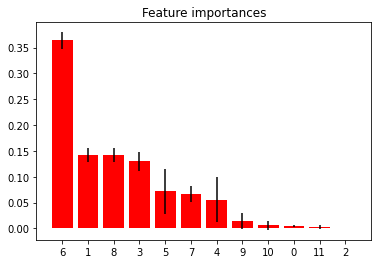

In [37]:
importances = forest.feature_importances_
std = np.std([tree.feature_importances_ for tree in forest.estimators_], axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")
df = pd.DataFrame()
for i, j in zip( x_train_n, forest.feature_importances_):
    aux = pd.DataFrame( {'feature': i, 'importance': j}, index=[0])
    df = pd.concat([df, aux], axis=0)

print( df.sort_values('importance', ascending=False))

# Plot the impurity-based feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(x_train_n.shape[1]), importances[indices], color="r", yerr=std[indices], align="center")
plt.xticks(range(x_train_n.shape[1]), indices)
plt.xlim([-1, x_train_n.shape[1]])
plt.show()

# 7.0. Machine Learning

In [45]:
cols_selected = ['annual_premium', 'vintage', 'age', 'region_code', 'vehicle_damage', 'previously_insured',
                 'policy_sales_channel']

x_train = df5[ cols_selected ]
x_val = x_validation[ cols_selected ]
y_val = y_validation

## 7.1. KNN

In [46]:
# model definithttp://localhost:8888/notebooks/notebooks/1.0.rbp_health_insurance_cross_sell.ipynb#7.1.-KNNion
knn_model = nh.KNeighborsClassifier( n_neighbors=7 )

# model training
knn_model.fit( x_train, y_train )

#model prediction
yhat_knn = knn_model.predict_proba( x_val )

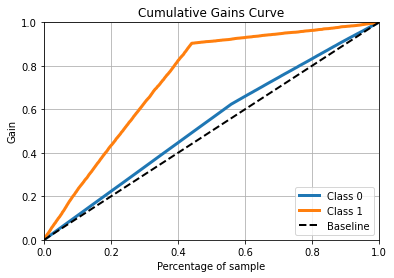

In [40]:
# Accumulative Gain
skplt.metrics.plot_cumulative_gain( y_val, yhat_knn );

## 7.2. Logistic Regression

/home/romario/.local/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


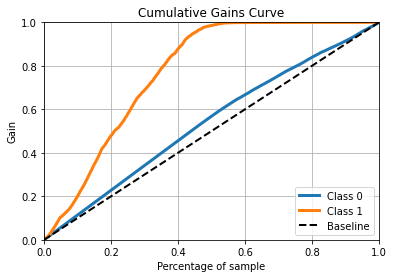

In [41]:
# model definition
lr_model = lm.LogisticRegression( random_state=42 )

# model training
lr_model.fit( x_train, y_train )

#model prediction
yhat_lr = lr_model.predict_proba( x_val )

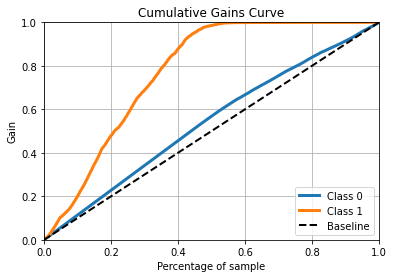

In [50]:
# Accumulative Gain
skplt.metrics.plot_cumulative_gain( y_val, yhat_lr );

## 7.3. Extra Trees

In [ ]:
# model definition
et = en.ExtraTreesClassifier( n_estimators=1000, n_jobs=-1, random_state=42)

#model fit
et.fit( x_train, y_train)

#model predict
yhat_et = et.predict_proba(x_val)

In [ ]:
#model predict
yhat_et = et.predict_proba(x_val)

In [ ]:
# Accumulative Gain
skplt.metrics.plot_cumulative_gain( y_val, yhat_et );

## 7.4. Random Forest

In [ ]:
# model definiion
rf = en.RandomForestClassifier( n_estimators=1000, n_jobs=-1, random_state=42)

# model trainin
rf.fit(x_train, y_train)

# model predict
yhat_rf = rf.predict_proba( x_val )

In [ ]:
# Accumulative Gain
skplt.metrics.plot_cumulative_gain( y_val, yhat_rf );

# 8.0. Model Performance

In [42]:
def precision_at_k( data, k=2000):

    # reset index
    data = df8.reset_index( drop=True )

    # create ranking order
    data['ranking'] = data.index +1

    data['precision_at_k'] = data['response'].cumsum() / data['ranking']

    return data.loc[k, 'precision_at_k']

In [43]:
def recall_at_k( data, k=2000):

    # reset index
    data = df8.reset_index( drop=True )

    # create ranking order
    data['ranking'] = data.index +1

    data['recall_at_k'] = data['response'].cumsum() / data['response'].sum()

    return data.loc[k, 'recall_at_k']

In [44]:
#copy data
df8 = x_validation.copy()
df8['response'] = y_validation.copy()

# propensity score
df8['score'] = yhat_knn[:,1].tolist()

# sort clients by propensity score
df8 = df8.sort_values( 'score', ascending=False)

# compute precision at k
precision_at_50 = precision_at_k (df8, k=50)
print('precision_at_K: {}'.format(precision_at_50))

# compute recall at k
recall_at_50 = recall_at_k (df8, k=50)
print('recall_at_K: {}'.format(recall_at_50))

precision_at_K: 0.3333333333333333
recall_at_K: 0.0018144946098836588


# 9.0. Deploy to Production

In [62]:
pickle.dump( lr_model, open( '/home/romario/repos/pa004_health_insurance_cross_sell/health_insurance_cross-sell/src/models/model_linear_regression.pkl', 'wb'))

## 9.1. Health Insurance Class

In [ ]:
class HealthInsurance:
    
    def __init__( self ):
        self.home_path = '/home/romario/repos/pa004_health_insurance_cross_sell/health_insurance_cross-sell'
        self.annual_premium_scaler =            pickle.load( open( self.home_path + 'src/feaures/annual_premium_scaler.pkl'))
        self.age_scaler =                       pickle.load( open( self.home_path + 'src/features/age_scaler.pkl'))
        self.vintage_scaler =                   pickle.load( open( self.home_path + 'src/features/vintage_scaler.pkl'))
        self.target_encode_gender_scaler =      pickle.load( open( self.home_path + 'src/features/target_encode_gender_scaler.pkl'))
        self.target_encode_region_code_scaler = pickle.load( open( self.home_path + 'src/features/target_encode_region_code_scaler.pkl'))
        self.fe_policy_sales_channel_scaler =   pickle.load( open( self.home_path + 'src/features/fe_policy_sales_channel_scaler.pkl'))
    
    def data_cleaning( self, df1 ):
        # Rename Columns
        cols_new = ['id', 'gender', 'age', 'driving_license', 'region_code',
                    'previously_insured', 'vehicle_age', 'vehicle_damage', 'annual_premium',
                    'policy_sales_channel', 'vintage', 'response']
        
        # Rename
        df1.columns = cols_new
    
    def feature_engineering( df2 ):
        # vehicle age
        df2['vehicle_age'] = df2['vehicle_age'].apply( lambda x: 'over_2_years' if x == '> 2 Years' else 'between_1_2_year' if x == '1-2 Year' else 'below_1_year' )

        # vehicle damage
        df2['vehicle_damage'] = df2['vehicle_damage'].apply( lambda x: 1 if x == 'Yes' else 0)
    
    def data_preparation( df5 ):
        # annual_premium
        df5['annual_premium'] = self.annual_premium_scaler.transform(df5[['annual_premium']].values)

        # Age
        df5['age'] = self.age_scaler.transform( df5[['age']].values)

        # vintage
        df5['vintage'] = self.vintage_scaler.transform( df5[['vintage']].values)
        
        
        df5.loc[:, 'gender'] = df5['gender'].map(self.target_encode_gender_scaler)
     

        # region_code - Frequency Encoding / Target Encoding / Weighted Target Encoding
        df5.loc[:, 'region_code'] = df5['region_code'].map(self.target_encode_region_code_scaler)
        

        # vehicle_age - One Hot Encoding / Order Encoding / Frequency Encoding
        df5 = pd.get_dummies( df5, prefix='vehicle_age', columns=['vehicle_age'])

        # policy_sales_channel - Target Encoding / Frequency Encoding
        df5.loc[:, 'policy_sales_channel'] = df5['policy_sales_channel'].map(self.fe_policy_sales_channel_scaler)
            
        # 6.0. Feature Selection
        cols_selected = ['annual_premium', 'vintage', 'age', 'region_code', 'vehicle_damage', 'previously_insured',
                         'policy_sales_channel']
        
        return df5[ cols_selected ]
    
    def get_predicion( self, model, original_data, test_data ):
        # model predicion
        pred = model.oredict_proba( test_data )
        
        #join predictio into original data
        original_data['score'] = pred
        
        return original_data.to_json( orient='records', date_format='iso')

# 9.2. API Handler

In [ ]:
import pickle
import pands as pd
from flask import Flask, request, Response
from healthinsurance import HealthInsurance

# initialize API
app = Flask( __name__ )

@app.route( '/predict', mehods=['POST'])

def health_insurance_predict():
    test_json = request.get_json()
    
    if isinstance(test_json, dict): #unique example
        test_raw = pd.DataFrame( test_json, index=[0])
        
        else: # multiple example
            test_raw = pd.DataFrame( test_json, columns=test_json[0].keys())
        
        # Instantiate HalthInsurance class
        pipeline = HealthInsurance()
        
        # data cleaning
        df1 = pipeline.data_cleaning( test_raw )
        
        # feature engineering
        df2 = pipeline.feature_engineering( df1 )
        
        # data preparation
        df3 = pipeline.data_preparation( df2 )
        
        # prediction
        df4 = pipeline.get_prediction(model, test_raw, df3)
        
        return df_response
    
    else:
        return Response( '{}', status=200, mimetype='application/json')

if __name__ == '__main__':
    app.run('0.0.0.0', debug=True)

# 9.3. API Tester

In [17]:
import requests

In [18]:
# Loading test dataset
df_test = x_validation
df_test['response'] = y_validation

/tmp/ipykernel_8218/1763846510.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test['response'] = y_validation


In [19]:
data = json.dumps( df_test.to_dict( orient='records'))

In [20]:
data

'[{"id": 10569, "gender": "Male", "age": 49, "driving_license": 1, "region_code": 29.0, "previously_insured": 1, "vehicle_age": "between_1_2_year", "vehicle_damage": 0, "annual_premium": 31191.0, "policy_sales_channel": 26.0, "vintage": 254, "response": 0}, {"id": 375681, "gender": "Female", "age": 24, "driving_license": 1, "region_code": 17.0, "previously_insured": 0, "vehicle_age": "below_1_year", "vehicle_damage": 0, "annual_premium": 38552.0, "policy_sales_channel": 152.0, "vintage": 74, "response": 0}, {"id": 80312, "gender": "Male", "age": 50, "driving_license": 1, "region_code": 28.0, "previously_insured": 0, "vehicle_age": "between_1_2_year", "vehicle_damage": 0, "annual_premium": 22031.0, "policy_sales_channel": 26.0, "vintage": 106, "response": 0}, {"id": 263510, "gender": "Male", "age": 40, "driving_license": 1, "region_code": 36.0, "previously_insured": 0, "vehicle_age": "between_1_2_year", "vehicle_damage": 1, "annual_premium": 50403.0, "policy_sales_channel": 26.0, "vinta

In [25]:
# API Call
url = 'https://health-insurance-predition-rbp.herokuapp.com/predict'
#url = 'https://health-insurance-model.herokuapp.com/predict'
#url = 'http://192.168.1.111:5000/predict'

header = {'Content-type': 'application/json'}

r = requests.post( url, data=data, headers=header)
print('Status Code {}'.format( r.status_code ))

Status Code 200


In [100]:
d1 = pd.DataFrame( r.json(), columns=r.json()[0].keys())
d1.sort_values('score', ascending=False).sample(10)

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage,response,score
73629,272482,0.103868,0.200000,1,0.076957,0,below_1_year,0,-1.625514,124.0,0.380623,1,0.030957
1747,6798,0.138919,0.446154,1,0.187850,0,below_1_year,0,0.310847,26.0,0.577855,0,0.050177
62634,243424,0.138919,0.446154,1,0.187850,1,below_1_year,0,-0.194888,124.0,0.851211,0,0.001108
57229,244758,0.103868,0.123077,1,0.187850,0,below_1_year,0,0.311254,26.0,0.768166,0,0.048299
57640,201219,0.138919,0.169231,1,0.124695,0,below_1_year,0,-0.240361,154.0,0.370242,0,0.042875
25721,64782,0.103868,0.123077,1,0.072155,0,below_1_year,0,-1.625514,152.0,0.318339,1,0.026790
48120,350071,0.103868,0.015385,1,0.075340,1,below_1_year,0,-0.182428,152.0,0.470588,0,0.000573
69760,264517,0.138919,0.507692,1,0.096529,0,below_1_year,0,0.084937,124.0,0.480969,0,0.034943
26664,98949,0.103868,0.092308,1,0.075107,0,below_1_year,0,0.075388,152.0,0.484429,0,0.027083
73039,372378,0.103868,0.507692,1,0.096529,1,below_1_year,0,1.164471,152.0,0.564014,0,0.000669
